In [ ]:
!apt-get update
!apt-get install -y libopencv-dev
!apt-get install -y libboost-all-dev
!git clone https://github.com/lava/matplotlib-cpp
!cd matplotlib-cpp && make

Hit:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease
Hit:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Get:3 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:4 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Hit:5 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:6 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:7 https://r2u.stat.illinois.edu/ubuntu jammy/main amd64 Packages [2,625 kB]
Get:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease [18.1 kB]
Hit:9 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:10 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Hit:11 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:12 https://r2u.stat.illinois.edu/ubuntu jammy/main all Packages [8,523 kB]
Get:13 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy/main amd64 Pac

In [ ]:
# import requests

# # URL gambar
# url = "https://i.pinimg.com/474x/d0/fe/4c/d0fe4ce233b0b5b7ba26b70c474ad418.jpg"

# # Download gambar dan simpan sebagai input.jpg
# response = requests.get(url)
# with open("input.jpg", "wb") as file:
#     file.write(response.content)

# print("Gambar berhasil diunduh dan disimpan sebagai 'input.jpg'.")

Saving naruto-shippuuden-masashi-kishimoto-uzumaki-naruto-haruno-sakura-wallpaper-66cff36f670b3d59d36c1341853565ad.jpg to naruto-shippuuden-masashi-kishimoto-uzumaki-naruto-haruno-sakura-wallpaper-66cff36f670b3d59d36c1341853565ad.jpg
Gambar berhasil di-upload dan disimpan sebagai 'input.jpg'.


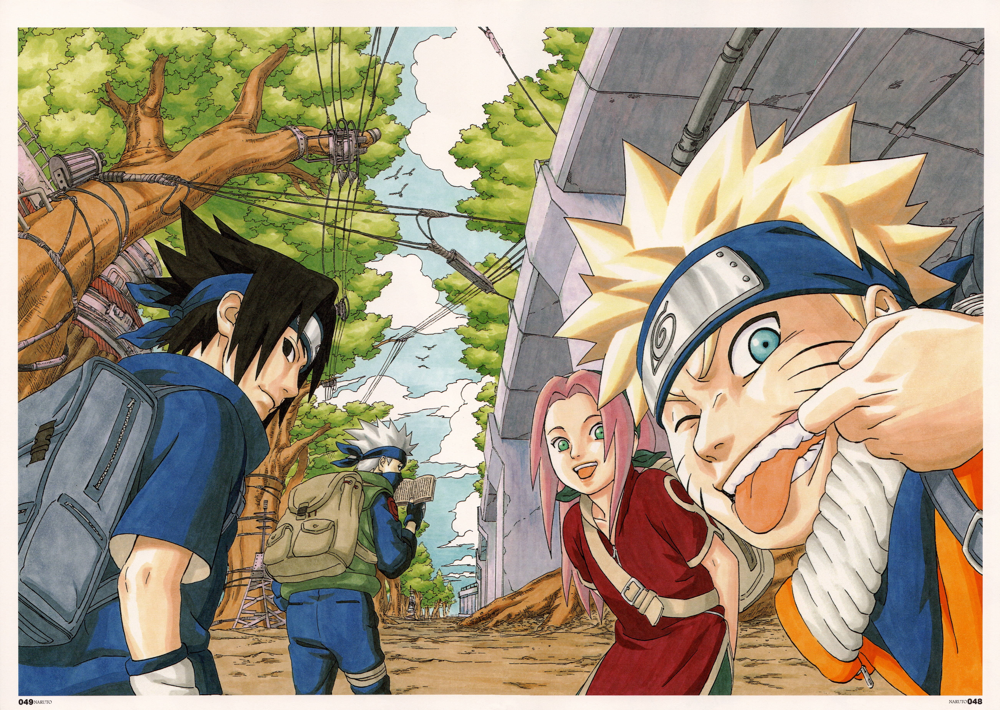

In [ ]:
from google.colab import files
import shutil
from IPython.display import Image, display

# Meminta pengguna untuk meng-upload gambar
uploaded = files.upload()

# Mengambil nama file gambar yang di-upload
for filename in uploaded.keys():
    # Pindahkan gambar ke file yang diinginkan (misalnya input.jpg)
    shutil.move(filename, "input.jpg")

print("Gambar berhasil di-upload dan disimpan sebagai 'input.jpg'.")

# Menampilkan gambar
display(Image(filename="input.jpg"))

In [ ]:
%%writefile imagefilters.cpp

#include <iostream>
#include <opencv2/opencv.hpp> // Pastikan OpenCV sudah terinstal
#include <chrono>

using namespace cv;
using namespace std;
using namespace chrono;

// Fungsi untuk mengubah gambar menjadi grayscale
void convertToGrayscale(Mat& input, Mat& output) {
    // Pastikan input memiliki 3 channel (RGB)
    if (input.channels() != 3) {
        cerr << "Gambar harus berformat RGB!" << endl;
        return;
    }

    for (int i = 0; i < input.rows; ++i) {
        for (int j = 0; j < input.cols; ++j) {
            Vec3b pixel = input.at<Vec3b>(i, j);
            // Konversi ke grayscale menggunakan rumus: Gray = 0.299 * R + 0.587 * G + 0.114 * B
            unsigned char gray = static_cast<unsigned char>(0.299 * pixel[2] + 0.587 * pixel[1] + 0.114 * pixel[0]);
            output.at<unsigned char>(i, j) = gray;
        }
    }
}

// Fungsi untuk mengubah gambar menjadi black and white berdasarkan threshold tanpa cvtColor
void convertToBlackAndWhite(Mat& input, Mat& output, unsigned char threshold) {
    // Pastikan input memiliki 3 channel (RGB)
    if (input.channels() != 3) {
        cerr << "Gambar harus berformat RGB!" << endl;
        return;
    }

    for (int i = 0; i < input.rows; ++i) {
        for (int j = 0; j < input.cols; ++j) {
            // Akses piksel RGB
            Vec3b pixel = input.at<Vec3b>(i, j);

            // Konversi ke grayscale menggunakan rumus
            unsigned char gray = static_cast<unsigned char>(0.299 * pixel[2] + 0.587 * pixel[1] + 0.114 * pixel[0]);

            // Terapkan threshold, jika lebih terang dari threshold, jadi putih (255), jika tidak, jadi hitam (0)
            output.at<unsigned char>(i, j) = (gray > threshold) ? 255 : 0;
        }
    }
}

// Fungsi untuk mengaplikasikan filter merah
void applyRedFilter(Mat& input, Mat& output) {
    for (int i = 0; i < input.rows; ++i) {
        for (int j = 0; j < input.cols; ++j) {
            Vec3b& pixel = output.at<Vec3b>(i, j);
            pixel[2] = min(255, pixel[2] + 30);  // Tingkatkan merah
            pixel[1] = max(0, pixel[1] - 30);    // Kurangi hijau
            pixel[0] = max(0, pixel[0] - 30);    // Kurangi biru
        }
    }
}

// Fungsi untuk mengaplikasikan filter biru
void applyBlueFilter(Mat& input, Mat& output) {
    for (int i = 0; i < input.rows; ++i) {
        for (int j = 0; j < input.cols; ++j) {
            Vec3b& pixel = output.at<Vec3b>(i, j);
            pixel[0] = min(255, pixel[0] + 30);  // Tambah biru
            pixel[1] = max(0, pixel[1] - 30);    // Kurangi hijau
            pixel[2] = max(0, pixel[2] - 30);    // Kurangi merah
        }
    }
}

int main() {
    int choice;
    cout << "Pilih filter yang akan dijalankan:" << endl;
    cout << "1: Grayscale" << endl;
    cout << "2: Black and White" << endl;
    cout << "3: Red Filter" << endl;
    cout << "4: Blue Filter" << endl;
    cout << "Masukkan pilihan Anda (1-4): ";
    cin >> choice;

    // Load gambar menggunakan OpenCV
    Mat img = imread("input.jpg"); // Ganti dengan path gambar Anda
    if (img.empty()) {
        cerr << "Error: Gambar tidak ditemukan!" << endl;
        return -1;
    }

    int channels = img.channels();

    Mat outputImg;

    if (choice == 1 || choice == 2) {
        outputImg = Mat::zeros(img.rows, img.cols, CV_8UC1); // Untuk grayscale atau B/W
    } else if (choice == 3 || choice == 4) {
        outputImg = img.clone(); // Salin data untuk filter RGB
    } else {
        cerr << "Pilihan tidak valid!" << endl;
        return -1;
    }


    // Mulai pengukuran waktu
    auto start = high_resolution_clock::now();

    if (choice == 1) {
        convertToGrayscale(img, outputImg);
    } else if (choice == 2) {
        unsigned char threshold = 128;
        convertToBlackAndWhite(img, outputImg, threshold);
    } else if (choice == 3) {
        applyRedFilter(img, outputImg);
    } else if (choice == 4) {
        applyBlueFilter(img, outputImg);
    } else {
        cerr << "Pilihan tidak valid!" << endl;
        return -1;
    }

    // Akhiri pengukuran waktu
    auto stop = high_resolution_clock::now();
    auto duration = duration_cast<milliseconds>(stop - start);

    cout << "Waktu eksekusi: " << duration.count() << " ms" << endl;

    // Simpan hasil
    imwrite("output_img.jpg", outputImg);
    cout << "Proses selesai. Gambar disimpan sebagai 'output_img.jpg'" << endl;

    return 0;
}

Overwriting imagefilters.cpp


In [ ]:
!g++ imagefilters.cpp -o imagefilters `pkg-config --cflags --libs opencv4`
!./imagefilters

Pilih filter yang akan dijalankan:
1: Grayscale
2: Black and White
3: Red Filter
4: Blue Filter
Masukkan pilihan Anda (1-4): 2
Waktu eksekusi: 633 ms
Proses selesai. Gambar disimpan sebagai 'output_img.jpg'


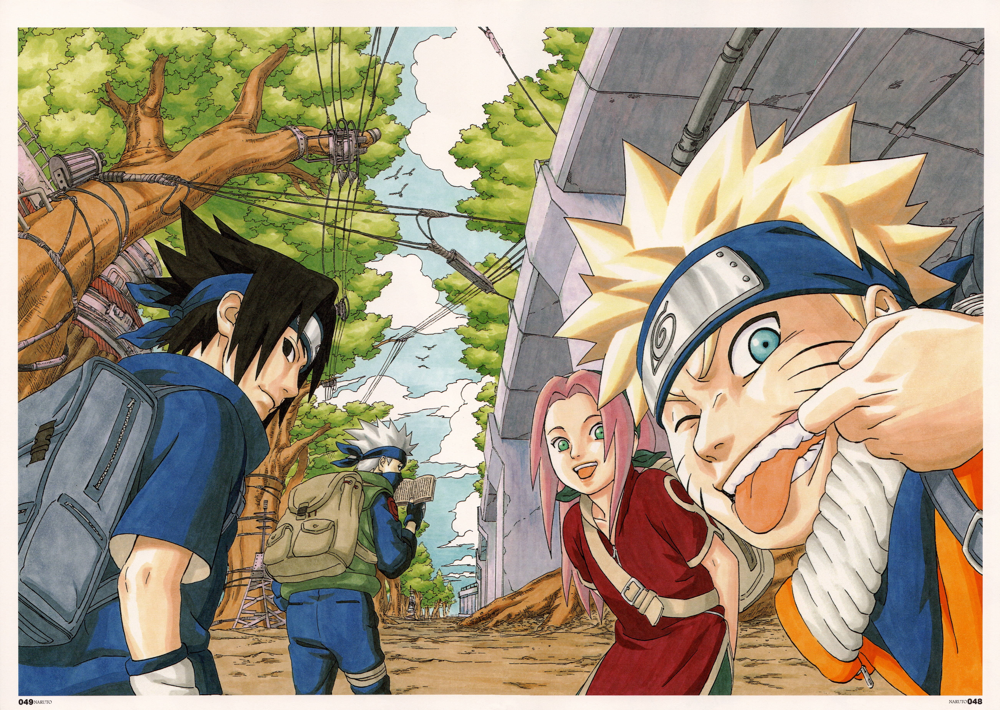

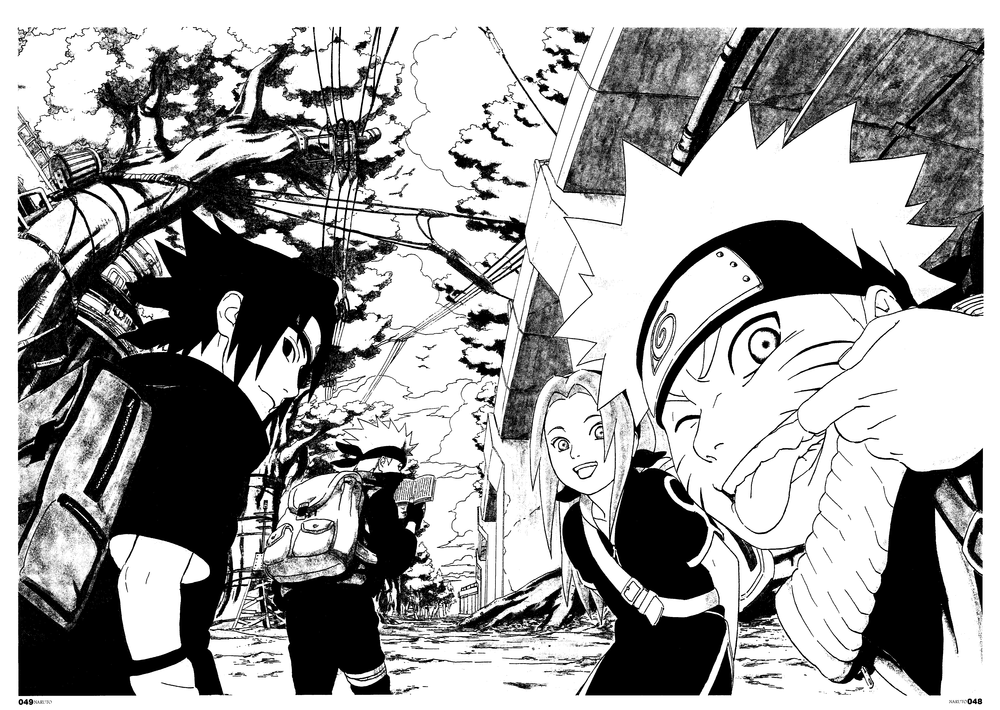

In [ ]:
from IPython.display import Image, display

display(Image("input.jpg"))
display(Image("output_img.jpg"))